In [3]:
import bs4 as bs
import requests

In [4]:
import yfinance as yf
import pandas as pd

In [5]:
import sqlite3
from sqlite3 import Error

In [46]:
# first need all the tickers for S&P 500 stocks

def save_sp500_tickers():
    resp = requests.get('http://en.wikipedia.org/wiki/List_of_S%26P_500_companies')
    soup = bs.BeautifulSoup(resp.text, 'lxml')
    table = soup.find('table', {'class': 'wikitable sortable'})
    tickers = []
    for row in table.findAll('tr')[1:]:
        ticker = row.findAll('td')[0].text[0:-1]
        tickers.append(ticker)
    return tickers

In [47]:
def save_sp500_companys():
    resp = requests.get('http://en.wikipedia.org/wiki/List_of_S%26P_500_companies')
    soup = bs.BeautifulSoup(resp.text, 'lxml')
    table = soup.find('table', {'class': 'wikitable sortable'})
    companys = []
    for row in table.findAll('tr')[1:]:
        company = row.findAll('td')[1].text
        companys.append(company)
    return companys

In [48]:
tickers_list = save_sp500_tickers()

In [64]:
companys_list = save_sp500_companys()

In [95]:
stocks_tuple = list(zip(tickers_list, companys_list))

In [98]:
#symbol(ticker) and corresponding company put into dataframe to be inserted into sqlite database
df_symbols_stocks = pd.DataFrame(stocks_tuple, columns= ['symbol','company'])

In [115]:
connection = sqlite3.connect(r'C:\Users\brian\stockapp.db')
cursor = connection.cursor()

In [116]:
df_symbols_stocks.to_sql('stock', connection, if_exists='append', index=False)

In [109]:
df = yfinance.download('AAPL', start = '2021-05-01', end ='2021-05-05', interval = '1d')

[*********************100%***********************]  1 of 1 completed


In [110]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2 entries, 2021-05-03 to 2021-05-04
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       2 non-null      float64
 1   High       2 non-null      float64
 2   Low        2 non-null      float64
 3   Close      2 non-null      float64
 4   Adj Close  2 non-null      float64
 5   Volume     2 non-null      int64  
dtypes: float64(5), int64(1)
memory usage: 112.0 bytes


In [111]:
df.head(10)

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2021-05-03,132.039993,134.070007,131.830002,132.539993,132.539993,75135100
2021-05-04,131.190002,131.490005,126.699997,127.849998,127.849998,137564700


In [107]:
df2 = yfinance.download('AAPL', start = '2021-05-01', end ='2021-05-05', interval = '1d', auto_adjust = True, prepost=True)

[*********************100%***********************]  1 of 1 completed


In [108]:
df2.head(10)

,Open,High,Low,Close,Volume
Date,,,,,
2021-05-03,132.039993,134.070007,131.830002,132.539993,75135100
2021-05-04,131.190002,131.490005,126.699997,127.849998,137564700


In [31]:
aapl= yfinance.Ticker("aapl")
aapl

yfinance.Ticker object <AAPL>

In [32]:
aapl_historical = aapl.history(start="2021-05-01", end="2021-05-05", interval="1m")
aapl_historical

,Open,High,Low,Close,Volume,Dividends,Stock Splits
Datetime,,,,,,,
2021-05-03 09:30:00-04:00,132.000000,132.100006,132.000000,132.063004,2325796,0,0
2021-05-03 09:31:00-04:00,132.059998,132.289993,131.990005,132.184998,477287,0,0
2021-05-03 09:32:00-04:00,132.199997,132.410004,132.160004,132.330002,385755,0,0
2021-05-03 09:33:00-04:00,132.324997,132.669998,132.220001,132.654999,575256,0,0
2021-05-03 09:34:00-04:00,132.654999,132.740005,132.559998,132.664993,476121,0,0
...,...,...,...,...,...,...,...
2021-05-04 15:55:00-04:00,127.375000,127.550003,127.349998,127.535004,713991,0,0
2021-05-04 15:56:00-04:00,127.540001,127.599998,127.519997,127.592796,539568,0,0
2021-05-04 15:57:00-04:00,127.599998,127.660004,127.570000,127.639999,585400,0,0


In [102]:
tickers_list= ['MMM']
tickers_data = {}
for ticker in tickers_list:
    ticker_object = yf.Ticker(ticker)

    #convert info() output from dictionary to dataframe
    temp = pd.DataFrame.from_dict(ticker_object.info, orient="index")
    temp.reset_index(inplace=True)
    temp.columns = ["Attribute", "Recent"]
    
    # add (ticker, dataframe) to main dictionary
    tickers_data[ticker] = temp

tickers_data

{'MMM':                     Attribute  \
 0                         zip   
 1                      sector   
 2           fullTimeEmployees   
 3         longBusinessSummary   
 4                        city   
 ..                        ...   
 118  impliedSharesOutstanding   
 119                  category   
 120     fiveYearAverageReturn   
 121        regularMarketPrice   
 122                  logo_url   
 
                                                 Recent  
 0                                           55144-1000  
 1                                          Industrials  
 2                                                95000  
 3    3M Company develops, manufactures, and markets...  
 4                                             St. Paul  
 ..                                                 ...  
 118                                               None  
 119                                               None  
 120                                               None  
 12

In [26]:
df3 = yf.download('AAPL', start = '2018-05-01', end = '2021-05-01', interval = '1d')

[*********************100%***********************]  1 of 1 completed


In [9]:
df3.to_csv('AAPL.csv')

In [45]:
tickers_list = save_sp500_tickers()

NameError: name 'save_sp500_tickers' is not defined

In [46]:
for ticker in tickers_list:
    data = yf.download(ticker, group_by = 'Ticker', start = '2018-05-01', end = '2021-05-01', interval = '1d')
    data['ticker'] = ticker
    data.to_csv(f'ticker_{ticker}.csv')

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

In [15]:
from pathlib import Path

In [16]:
p = Path(r'C:\Users\brian\Classification\data\stock_csv')
files = list(p.glob('ticker_*.csv'))
df_list = list()
for file in files:
    df_list.append(pd.read_csv(file))

df = pd.concat(df_list)

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 378398 entries, 0 to 755
Data columns (total 8 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Date       378398 non-null  object 
 1   Open       378397 non-null  float64
 2   High       378397 non-null  float64
 3   Low        378397 non-null  float64
 4   Close      378397 non-null  float64
 5   Adj Close  378397 non-null  float64
 6   Volume     378397 non-null  float64
 7   ticker     378398 non-null  object 
dtypes: float64(6), object(2)
memory usage: 26.0+ MB


In [50]:
df.head(10)

,Date,Open,High,Low,Close,Adj Close,Volume,ticker
0,2018-05-01,65.629997,66.349998,65.489998,66.239998,64.598282,3135100.0,A
1,2018-05-02,66.000000,66.860001,65.769997,65.910004,64.276466,2240500.0,A
2,2018-05-03,65.769997,66.459999,64.860001,66.339996,64.695808,2365900.0,A
3,2018-05-04,66.029999,67.250000,65.540001,67.000000,65.339455,1330800.0,A
4,2018-05-07,67.160004,67.980003,67.070000,67.389999,65.719795,1468700.0,A
5,2018-05-08,67.080002,67.440002,66.839996,67.370003,65.700294,1916100.0,A
6,2018-05-09,67.379997,68.410004,67.150002,68.129997,66.441437,2108500.0,A
7,2018-05-10,68.120003,68.879997,68.120003,68.860001,67.153343,1844900.0,A
8,2018-05-11,69.190002,69.599998,68.910004,69.449997,67.728722,1524200.0,A
9,2018-05-14,69.730003,70.449997,69.000000,69.209999,67.494675,3322600.0,A


In [51]:
df.to_csv('base_data.csv')

In [8]:
df = pd.read_csv(r'C:\Users\brian\Classification\data\base_data.csv')

In [9]:
connection = sqlite3.connect(r'C:\Users\brian\stockapp.db')
connection.row_factory = sqlite3.Row
cursor = connection.cursor()
cursor.execute("""
        SELECT id, symbol, company FROM stock
""")

rows = cursor.fetchall()

In [94]:
symbols = []
stock_dict = {}
for row in rows:
    symbol = row['symbol']
    symbols.append(symbol)
    stock_dict[symbol] = row['id']

for ticker in symbols:
    specific_df = df[df['ticker'] == ticker]
    stock_id = stock_dict[ticker]
    for i in range(len(specific_df)):
        cursor.execute("""
        INSERT INTO stock_price (stock_id, date, open, high, low, close, adjusted_close, volume)
        VALUES(?, ?, ?, ?, ?, ?, ?, ?)
        """, (stock_id, specific_df.iloc[i]['Date'], specific_df.iloc[i]['Open'], specific_df.iloc[i]['High'], specific_df.iloc[i]['Low'], 
        specific_df.iloc[i]['Close'], specific_df.iloc[i]['Adj Close'], specific_df.iloc[i]['Volume']))

connection.commit()
        

In [44]:
test = ['A', 'MMM']
for symbol in test:
    print(df[df['ticker']==symbol])

           Date        Open        High         Low       Close   Adj Close  \
0    2019-05-01   78.489998   78.919998   77.279999   77.470001   76.235962   
1    2019-05-02   77.410004   78.339996   77.150002   78.199997   76.954338   
2    2019-05-03   78.580002   79.559998   78.580002   79.290001   78.026978   
3    2019-05-06   77.620003   79.410004   77.209999   79.349998   78.086021   
4    2019-05-07   78.589996   78.769997   76.029999   76.669998   75.448715   
..          ...         ...         ...         ...         ...         ...   
500  2021-04-26  137.210007  137.830002  136.679993  137.339996  137.339996   
501  2021-04-27  136.929993  137.440002  136.229996  136.479996  136.479996   
502  2021-04-28  136.000000  136.509995  134.710007  134.800003  134.800003   
503  2021-04-29  135.410004  135.410004  133.539993  134.149994  134.149994   
504  2021-04-30  133.899994  134.660004  133.149994  133.639999  133.639999   

      Volume ticker  
0    1078600      A  
1     9

In [52]:
test = df[df['ticker']== 'A']

In [56]:
test.iloc[0]

Date         2018-05-01
Open          65.629997
High          66.349998
Low           65.489998
Close         66.239998
Adj Close     64.598282
Volume        3135100.0
ticker                A
Name: 0, dtype: object

In [57]:
test.iloc[0]['Date']

'2018-05-01'

In [58]:
len(test)

756

In [67]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 378398 entries, 0 to 755
Data columns (total 8 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Date       378398 non-null  object 
 1   Open       378397 non-null  float64
 2   High       378397 non-null  float64
 3   Low        378397 non-null  float64
 4   Close      378397 non-null  float64
 5   Adj Close  378397 non-null  float64
 6   Volume     378397 non-null  float64
 7   ticker     378398 non-null  object 
dtypes: float64(6), object(2)
memory usage: 26.0+ MB


In [18]:
df.describe()

,Open,High,Low,Close,Adj Close,Volume
count,378397.000000,378397.000000,378397.000000,378397.000000,378397.000000,3.783970e+05
mean,136.058932,137.749758,134.338804,136.081041,133.660217,4.866622e+06
std,241.834461,245.067234,238.678277,241.916556,241.908704,1.159690e+07
min,3.220000,3.290000,3.020000,3.120000,3.092542,0.000000e+00
25%,48.060001,48.680000,47.439999,48.070000,46.349556,1.012400e+06
50%,84.830002,85.830002,83.790001,84.820000,82.227470,2.028100e+06
75%,147.429993,149.080002,145.699997,147.399994,144.392029,4.466000e+06
max,5020.000000,5107.100098,5000.310059,5023.910156,5023.910156,4.286171e+08


In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 378398 entries, 0 to 755
Data columns (total 8 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Date       378398 non-null  object 
 1   Open       378397 non-null  float64
 2   High       378397 non-null  float64
 3   Low        378397 non-null  float64
 4   Close      378397 non-null  float64
 5   Adj Close  378397 non-null  float64
 6   Volume     378397 non-null  float64
 7   ticker     378398 non-null  object 
dtypes: float64(6), object(2)
memory usage: 26.0+ MB


**Found one null value**

In [41]:
df[df['Open'].isna() == True]

,Date,Open,High,Low,Close,Adj Close,Volume,ticker
152,2018-12-05,NaN,NaN,NaN,NaN,NaN,NaN,ODFL


In [66]:
df.iloc[260331]

Date         2018-12-05
Open                NaN
High                NaN
Low                 NaN
Close               NaN
Adj Close           NaN
Volume              NaN
ticker             ODFL
Name: 152, dtype: object

In [67]:
#decide to fill it in with the mean value of the week
ODFL = df[df['ticker']=='ODFL']
ODFL.describe()

,Open,High,Low,Close,Adj Close,Volume
count,756.000000,756.000000,756.000000,756.000000,756.000000,7.560000e+02
mean,137.248258,139.193849,135.504916,137.353249,136.724044,8.396308e+05
std,47.105040,47.647072,46.662137,47.118556,47.399080,8.850759e+05
min,77.233330,79.053337,76.666664,77.053337,76.376854,1.469000e+05
25%,98.776669,99.825001,97.438334,98.804998,97.661058,5.998500e+05
50%,117.366669,120.323334,117.110001,118.820000,118.308670,7.297500e+05
75%,182.545002,186.105000,181.237503,182.507500,182.178776,9.396250e+05
max,258.709991,261.170013,256.750000,259.309998,259.309998,2.323380e+07


In [83]:
ODFL.iloc[150:155]

,Date,Open,High,Low,Close,Adj Close,Volume,ticker
150,2018-12-03,92.873337,93.333336,89.866669,90.326668,89.309380,636400.0,ODFL
151,2018-12-04,89.633331,89.726669,83.800003,86.446663,85.473068,1509400.0,ODFL
152,2018-12-05,NaN,NaN,NaN,NaN,NaN,NaN,ODFL
153,2018-12-06,84.833336,89.733330,83.953331,89.459999,88.674591,1554400.0,ODFL
154,2018-12-07,90.000000,90.813332,85.293335,85.833336,85.079765,1186200.0,ODFL


In [82]:
# mean values of the week with the null value
null_week_ODFL = ODFL.iloc[150:155]
null_week_ODFL.describe()

,Open,High,Low,Close,Adj Close,Volume
count,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000e+00
mean,89.335001,90.901667,85.728334,88.016666,87.134201,1.221600e+06
std,3.332468,1.699652,2.839257,2.209914,2.166739,4.232009e+05
min,84.833336,89.726669,83.800003,85.833336,85.079765,6.364000e+05
25%,88.433332,89.731665,83.914999,86.293331,85.374743,1.048750e+06
50%,89.816666,90.273331,84.623333,87.953331,87.073830,1.347800e+06
75%,90.718334,91.443333,86.436668,89.676666,88.833288,1.520650e+06
max,92.873337,93.333336,89.866669,90.326668,89.309380,1.554400e+06


In [91]:
df['Open'].fillna(89.335001, inplace=True)
df['High'].fillna(90.901667, inplace=True)
df['Low'].fillna(85.728334, inplace=True)
df['Close'].fillna(88.016666, inplace=True)
df['Adj Close'].fillna(87.134201, inplace=True)
df['Volume'].fillna(1.221600e+06, inplace=True)

In [92]:
df.iloc[260331]

Date         2018-12-05
Open          89.335001
High          90.901667
Low           85.728334
Close         88.016666
Adj Close     87.134201
Volume        1221600.0
ticker             ODFL
Name: 152, dtype: object

In [96]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 378398 entries, 0 to 755
Data columns (total 8 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Date       378398 non-null  object 
 1   Open       378398 non-null  float64
 2   High       378398 non-null  float64
 3   Low        378398 non-null  float64
 4   Close      378398 non-null  float64
 5   Adj Close  378398 non-null  float64
 6   Volume     378398 non-null  float64
 7   ticker     378398 non-null  object 
dtypes: float64(6), object(2)
memory usage: 26.0+ MB


In [95]:
df.to_csv('base_data.csv')

In [15]:
del df['Unnamed: 0']

In [16]:
df.head(10)

,Date,Open,High,Low,Close,Adj Close,Volume,ticker
0,2018-05-01,65.629997,66.349998,65.489998,66.239998,64.598282,3135100.0,A
1,2018-05-02,66.000000,66.860001,65.769997,65.910004,64.276466,2240500.0,A
2,2018-05-03,65.769997,66.459999,64.860001,66.339996,64.695808,2365900.0,A
3,2018-05-04,66.029999,67.250000,65.540001,67.000000,65.339455,1330800.0,A
4,2018-05-07,67.160004,67.980003,67.070000,67.389999,65.719795,1468700.0,A
5,2018-05-08,67.080002,67.440002,66.839996,67.370003,65.700294,1916100.0,A
6,2018-05-09,67.379997,68.410004,67.150002,68.129997,66.441437,2108500.0,A
7,2018-05-10,68.120003,68.879997,68.120003,68.860001,67.153343,1844900.0,A
8,2018-05-11,69.190002,69.599998,68.910004,69.449997,67.728722,1524200.0,A
9,2018-05-14,69.730003,70.449997,69.000000,69.209999,67.494675,3322600.0,A


### Give each datapoint a target variable
**Pf = mean of price for week(future) = (sum of adjusted closing price for the next 5 days)/5  
Pc = current adjusted closing price  
return percentage = ((Pf - Pc)/Pc) * 100  
target variable = return percentage**

In [17]:
test = df.head(10)

In [28]:
indexer = pd.api.indexers.FixedForwardWindowIndexer(window_size=5)
test['rolling_avg'] = test['Adj Close'].rolling(window=indexer, min_periods=5).mean()
    

<ipython-input-28-b2b73ce8f3ec>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['rolling_avg'] = test['Adj Close'].rolling(window=indexer, min_periods=5).mean()


In [50]:
test['target'] = ((test['rolling_avg'] - test['Adj Close'])/test['Adj Close'])*100

<ipython-input-50-72d90334c1c1>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['target'] = ((test['rolling_avg'] - test['Adj Close'])/test['Adj Close'])*100


In [51]:
test

,Date,Open,High,Low,Close,Adj Close,Volume,ticker,target,rolling_avg
0,2018-05-01,65.629997,66.349998,65.489998,66.239998,64.598282,3135100.0,A,0.507257,64.925961
1,2018-05-02,66.000000,66.860001,65.769997,65.910004,64.276466,2240500.0,A,1.353369,65.146364
2,2018-05-03,65.769997,66.459999,64.860001,66.339996,64.695808,2365900.0,A,1.365698,65.579358
3,2018-05-04,66.029999,67.250000,65.540001,67.000000,65.339455,1330800.0,A,1.119401,66.070865
4,2018-05-07,67.160004,67.980003,67.070000,67.389999,65.719795,1468700.0,A,1.261299,66.548718
5,2018-05-08,67.080002,67.440002,66.839996,67.370003,65.700294,1916100.0,A,1.831650,66.903694
6,2018-05-09,67.379997,68.410004,67.150002,68.129997,66.441437,2108500.0,A,NaN,NaN
7,2018-05-10,68.120003,68.879997,68.120003,68.860001,67.153343,1844900.0,A,NaN,NaN
8,2018-05-11,69.190002,69.599998,68.910004,69.449997,67.728722,1524200.0,A,NaN,NaN
9,2018-05-14,69.730003,70.449997,69.000000,69.209999,67.494675,3322600.0,A,NaN,NaN


In [57]:
ticker_list = list(df['ticker'].unique())

In [58]:
ticker_list

['A',
 'AAL',
 'AAP',
 'AAPL',
 'ABBV',
 'ABC',
 'ABMD',
 'ABT',
 'ACN',
 'ADBE',
 'ADI',
 'ADM',
 'ADP',
 'ADSK',
 'AEE',
 'AEP',
 'AES',
 'AFL',
 'AIG',
 'AIZ',
 'AJG',
 'AKAM',
 'ALB',
 'ALGN',
 'ALK',
 'ALL',
 'ALLE',
 'ALXN',
 'AMAT',
 'AMCR',
 'AMD',
 'AME',
 'AMGN',
 'AMP',
 'AMT',
 'AMZN',
 'ANET',
 'ANSS',
 'ANTM',
 'AON',
 'AOS',
 'APA',
 'APD',
 'APH',
 'APTV',
 'ARE',
 'ATO',
 'ATVI',
 'AVB',
 'AVGO',
 'AVY',
 'AWK',
 'AXP',
 'AZO',
 'BA',
 'BAC',
 'BAX',
 'BBY',
 'BDX',
 'BEN',
 'BIIB',
 'BIO',
 'BK',
 'BKNG',
 'BKR',
 'BLK',
 'BLL',
 'BMY',
 'BR',
 'BSX',
 'BWA',
 'BXP',
 'C',
 'CAG',
 'CAH',
 'CARR',
 'CAT',
 'CB',
 'CBOE',
 'CBRE',
 'CCI',
 'CCL',
 'CDNS',
 'CDW',
 'CE',
 'CERN',
 'CF',
 'CFG',
 'CHD',
 'CHRW',
 'CHTR',
 'CI',
 'CINF',
 'CL',
 'CLX',
 'CMA',
 'CMCSA',
 'CME',
 'CMG',
 'CMI',
 'CMS',
 'CNC',
 'CNP',
 'COF',
 'COG',
 'COO',
 'COP',
 'COST',
 'CPB',
 'CPRT',
 'CRM',
 'CSCO',
 'CSX',
 'CTAS',
 'CTLT',
 'CTSH',
 'CTVA',
 'CTXS',
 'CVS',
 'CVX',
 'CZR',
 'D',

In [ ]:
test['rolling_avg'] = test['Adj Close'].rolling(window=indexer, min_periods=5).mean()
test['target'] = ((test['rolling_avg'] - test['Adj Close'])/test['Adj Close'])*100

In [61]:
indexer = pd.api.indexers.FixedForwardWindowIndexer(window_size=5)
target_moving_average_df = pd.DataFrame()
for ticker in ticker_list:
    single_ticker_df = df[df['ticker'] == ticker]
    single_ticker_df['future_rolling_avg'] = single_ticker_df['Adj Close'].rolling(window=indexer, min_periods=5).mean()
    single_ticker_df['past_rolling_avg'] = single_ticker_df['Adj Close'].rolling(5).mean()
    single_ticker_df['target'] = ((single_ticker_df['future_rolling_avg'] - single_ticker_df['Adj Close'])/single_ticker_df['Adj Close'])*100
    target_moving_average_df = target_moving_average_df.append(single_ticker_df)

<ipython-input-61-7ca506d04036>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  single_ticker_df['future_rolling_avg'] = single_ticker_df['Adj Close'].rolling(window=indexer, min_periods=5).mean()
<ipython-input-61-7ca506d04036>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  single_ticker_df['past_rolling_avg'] = single_ticker_df['Adj Close'].rolling(5).mean()
<ipython-input-61-7ca506d04036>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_

In [62]:
target_moving_average_df.head(10)

,Date,Open,High,Low,Close,Adj Close,Volume,ticker,future_rolling_avg,past_rolling_avg,target
0,2018-05-01,65.629997,66.349998,65.489998,66.239998,64.598282,3135100.0,A,64.925961,NaN,0.507257
1,2018-05-02,66.000000,66.860001,65.769997,65.910004,64.276466,2240500.0,A,65.146364,NaN,1.353369
2,2018-05-03,65.769997,66.459999,64.860001,66.339996,64.695808,2365900.0,A,65.579358,NaN,1.365698
3,2018-05-04,66.029999,67.250000,65.540001,67.000000,65.339455,1330800.0,A,66.070865,NaN,1.119401
4,2018-05-07,67.160004,67.980003,67.070000,67.389999,65.719795,1468700.0,A,66.548718,64.925961,1.261299
5,2018-05-08,67.080002,67.440002,66.839996,67.370003,65.700294,1916100.0,A,66.903694,65.146364,1.831650
6,2018-05-09,67.379997,68.410004,67.150002,68.129997,66.441437,2108500.0,A,65.953831,65.579358,-0.733887
7,2018-05-10,68.120003,68.879997,68.120003,68.860001,67.153343,1844900.0,A,64.746516,66.070865,-3.584076
8,2018-05-11,69.190002,69.599998,68.910004,69.449997,67.728722,1524200.0,A,63.718642,66.548718,-5.920797
9,2018-05-14,69.730003,70.449997,69.000000,69.209999,67.494675,3322600.0,A,62.718074,66.903694,-7.077004


In [64]:
target_moving_average_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 378398 entries, 0 to 378397
Data columns (total 11 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   Date                378398 non-null  object 
 1   Open                378398 non-null  float64
 2   High                378398 non-null  float64
 3   Low                 378398 non-null  float64
 4   Close               378398 non-null  float64
 5   Adj Close           378398 non-null  float64
 6   Volume              378398 non-null  float64
 7   ticker              378398 non-null  object 
 8   future_rolling_avg  376386 non-null  float64
 9   past_rolling_avg    376386 non-null  float64
 10  target              376386 non-null  float64
dtypes: float64(9), object(2)
memory usage: 34.6+ MB


In [65]:
target_moving_average_df = target_moving_average_df.dropna()

In [66]:
target_moving_average_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 374374 entries, 4 to 378393
Data columns (total 11 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   Date                374374 non-null  object 
 1   Open                374374 non-null  float64
 2   High                374374 non-null  float64
 3   Low                 374374 non-null  float64
 4   Close               374374 non-null  float64
 5   Adj Close           374374 non-null  float64
 6   Volume              374374 non-null  float64
 7   ticker              374374 non-null  object 
 8   future_rolling_avg  374374 non-null  float64
 9   past_rolling_avg    374374 non-null  float64
 10  target              374374 non-null  float64
dtypes: float64(9), object(2)
memory usage: 34.3+ MB


In [85]:
def positive_or_negative(number):
    if number > 0:
        return 1
    else:
        return 0

In [86]:
target_moving_average_df['trend'] = target_moving_average_df['target'].apply(positive_or_negative)

## Fitting the data into a basic logistic regression without any feature engineering

In [22]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('fivethirtyeight')

%matplotlib inline

# modeling imports
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_score, recall_score, accuracy_score, roc_auc_score
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import StandardScaler

In [76]:
target_moving_average_df['Date'] = pd.to_datetime(target_moving_average_df['Date'])

In [79]:
target_moving_average_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 374374 entries, 4 to 378393
Data columns (total 11 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Date                374374 non-null  datetime64[ns]
 1   Open                374374 non-null  float64       
 2   High                374374 non-null  float64       
 3   Low                 374374 non-null  float64       
 4   Close               374374 non-null  float64       
 5   Adj Close           374374 non-null  float64       
 6   Volume              374374 non-null  float64       
 7   ticker              374374 non-null  object        
 8   future_rolling_avg  374374 non-null  float64       
 9   past_rolling_avg    374374 non-null  float64       
 10  target              374374 non-null  float64       
dtypes: datetime64[ns](1), float64(9), object(1)
memory usage: 34.3+ MB


In [100]:
test_set = target_moving_average_df[target_moving_average_df['ticker'] == 'AAPL']

In [101]:
test_set.iloc[598]

Date                  2020-09-21 00:00:00
Open                           104.540001
High                           110.190002
Low                            103.099998
Close                          110.080002
Adj Close                      109.726448
Volume                        195713800.0
ticker                               AAPL
future_rolling_avg             109.549017
past_rolling_avg               110.629536
target                          -0.161703
trend                                   0
Name: 2870, dtype: object

In [104]:
test_set.iloc[747]

Date                  2021-04-26 00:00:00
Open                           134.830002
High                           135.059998
Low                            133.559998
Close                          134.720001
Adj Close                      134.720001
Volume                         66905100.0
ticker                               AAPL
future_rolling_avg             133.526001
past_rolling_avg               133.518002
target                          -0.886283
trend                                   0
Name: 3019, dtype: object

In [108]:
train = pd.DataFrame()
test = pd.DataFrame()
for ticker in ticker_list:
    single_ticker_df = target_moving_average_df[target_moving_average_df['ticker'] == ticker]
    train = train.append(single_ticker_df[:599])
    test = test.append(single_ticker_df[599:])

In [109]:
X_train = train[['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'past_rolling_avg']]
X_test = test[['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'past_rolling_avg']]
y_train = train[['trend']]
y_test = test[['trend']]

In [157]:
lm1 = LogisticRegression(C=1000) #setting C very high essentially removes regularization
lm1.fit(X_train, y_train.values.ravel())

LogisticRegression(C=1000)

In [158]:
lm1.score(X_train, y_train)

0.5428642781033565

In [159]:
lm1.score(X_test, y_test)

0.5869770707861831

## Using Technical Analysis library for features

In [119]:
from ta import add_all_ta_features
from ta.volatility import BollingerBands

In [172]:
tech_test = df[df['ticker']=='AAPL']

In [173]:
tech_test

,Date,Open,High,Low,Close,Adj Close,Volume,ticker
2268,2018-05-01,41.602501,42.299999,41.317501,42.275002,40.786770,214277600.0,AAPL
2269,2018-05-02,43.807499,44.437500,43.450001,44.142502,42.588531,266157600.0,AAPL
2270,2018-05-03,43.970001,44.375000,43.610001,44.222500,42.665707,136272800.0,AAPL
2271,2018-05-04,44.562500,46.062500,44.542500,45.957500,44.339626,224805200.0,AAPL
2272,2018-05-07,46.294998,46.917500,46.187500,46.290001,44.660423,169805600.0,AAPL
...,...,...,...,...,...,...,...,...
3019,2021-04-26,134.830002,135.059998,133.559998,134.720001,134.720001,66905100.0,AAPL
3020,2021-04-27,135.009995,135.410004,134.110001,134.389999,134.389999,66015800.0,AAPL
3021,2021-04-28,134.309998,135.020004,133.080002,133.580002,133.580002,107760100.0,AAPL
3022,2021-04-29,136.470001,137.070007,132.449997,133.479996,133.479996,151101000.0,AAPL


In [133]:
indicator_bb = BollingerBands(close=df["Adj Close"], window=20, window_dev=2)

In [174]:
tech_test = add_all_ta_features(
    tech_test, open="Open", high="High", low="Low", close="Close", volume="Volume")

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

In [175]:
tech_test.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'ticker',
       'volume_adi', 'volume_obv', 'volume_cmf', 'volume_fi', 'volume_mfi',
       'volume_em', 'volume_sma_em', 'volume_vpt', 'volume_nvi', 'volume_vwap',
       'volatility_atr', 'volatility_bbm', 'volatility_bbh', 'volatility_bbl',
       'volatility_bbw', 'volatility_bbp', 'volatility_bbhi',
       'volatility_bbli', 'volatility_kcc', 'volatility_kch', 'volatility_kcl',
       'volatility_kcw', 'volatility_kcp', 'volatility_kchi',
       'volatility_kcli', 'volatility_dcl', 'volatility_dch', 'volatility_dcm',
       'volatility_dcw', 'volatility_dcp', 'volatility_ui', 'trend_macd',
       'trend_macd_signal', 'trend_macd_diff', 'trend_sma_fast',
       'trend_sma_slow', 'trend_ema_fast', 'trend_ema_slow', 'trend_adx',
       'trend_adx_pos', 'trend_adx_neg', 'trend_vortex_ind_pos',
       'trend_vortex_ind_neg', 'trend_vortex_ind_diff', 'trend_trix',
       'trend_mass_index', 'trend_cci', 'trend_dpo', 

In [176]:
tech_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 756 entries, 2268 to 3023
Data columns (total 91 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Date                       756 non-null    object 
 1   Open                       756 non-null    float64
 2   High                       756 non-null    float64
 3   Low                        756 non-null    float64
 4   Close                      756 non-null    float64
 5   Adj Close                  756 non-null    float64
 6   Volume                     756 non-null    float64
 7   ticker                     756 non-null    object 
 8   volume_adi                 756 non-null    float64
 9   volume_obv                 756 non-null    float64
 10  volume_cmf                 737 non-null    float64
 11  volume_fi                  743 non-null    float64
 12  volume_mfi                 743 non-null    float64
 13  volume_em                  755 non-null    flo

**important features**
ta.trend.EMAIndicator
ta.trend.MACD

**delete**
trend_psar_up
trend_psar_down
trend_stc

In [178]:
del tech_test['trend_psar_up']
del tech_test['trend_psar_down']
del tech_test['trend_stc']

In [205]:
target_moving_average_df.head(10)

,Date,Open,High,Low,Close,Adj Close,Volume,ticker,future_rolling_avg,past_rolling_avg,target,trend
4,2018-05-07,67.160004,67.980003,67.070000,67.389999,65.719795,1468700.0,A,66.548718,64.925961,1.261299,1
5,2018-05-08,67.080002,67.440002,66.839996,67.370003,65.700294,1916100.0,A,66.903694,65.146364,1.831650,1
6,2018-05-09,67.379997,68.410004,67.150002,68.129997,66.441437,2108500.0,A,65.953831,65.579358,-0.733887,0
7,2018-05-10,68.120003,68.879997,68.120003,68.860001,67.153343,1844900.0,A,64.746516,66.070865,-3.584076,0
8,2018-05-11,69.190002,69.599998,68.910004,69.449997,67.728722,1524200.0,A,63.718642,66.548718,-5.920797,0
9,2018-05-14,69.730003,70.449997,69.000000,69.209999,67.494675,3322600.0,A,62.718074,66.903694,-7.077004,0
10,2018-05-15,61.840000,64.099998,60.700001,62.500000,60.950981,14451200.0,A,62.004218,65.953831,1.728007,1
11,2018-05-16,62.509998,62.990002,61.650002,61.939999,60.404861,5872500.0,A,62.460618,64.746516,3.403296,1
12,2018-05-17,61.980000,63.910000,61.759998,63.590000,62.013969,5211300.0,A,62.965780,63.718642,1.534832,1
13,2018-05-18,63.630001,64.599998,63.509998,64.320000,62.725883,4163500.0,A,63.069154,62.718074,0.547254,1


In [236]:
ticker_list = list(df['ticker'].unique())
ticker_list

['A',
 'AAL',
 'AAP',
 'AAPL',
 'ABBV',
 'ABC',
 'ABMD',
 'ABT',
 'ACN',
 'ADBE',
 'ADI',
 'ADM',
 'ADP',
 'ADSK',
 'AEE',
 'AEP',
 'AES',
 'AFL',
 'AIG',
 'AIZ',
 'AJG',
 'AKAM',
 'ALB',
 'ALGN',
 'ALK',
 'ALL',
 'ALLE',
 'ALXN',
 'AMAT',
 'AMCR',
 'AMD',
 'AME',
 'AMGN',
 'AMP',
 'AMT',
 'AMZN',
 'ANET',
 'ANSS',
 'ANTM',
 'AON',
 'AOS',
 'APA',
 'APD',
 'APH',
 'APTV',
 'ARE',
 'ATO',
 'ATVI',
 'AVB',
 'AVGO',
 'AVY',
 'AWK',
 'AXP',
 'AZO',
 'BA',
 'BAC',
 'BAX',
 'BBY',
 'BDX',
 'BEN',
 'BIIB',
 'BIO',
 'BK',
 'BKNG',
 'BKR',
 'BLK',
 'BLL',
 'BMY',
 'BR',
 'BSX',
 'BWA',
 'BXP',
 'C',
 'CAG',
 'CAH',
 'CARR',
 'CAT',
 'CB',
 'CBOE',
 'CBRE',
 'CCI',
 'CCL',
 'CDNS',
 'CDW',
 'CE',
 'CERN',
 'CF',
 'CFG',
 'CHD',
 'CHRW',
 'CHTR',
 'CI',
 'CINF',
 'CL',
 'CLX',
 'CMA',
 'CMCSA',
 'CME',
 'CMG',
 'CMI',
 'CMS',
 'CNC',
 'CNP',
 'COF',
 'COG',
 'COO',
 'COP',
 'COST',
 'CPB',
 'CPRT',
 'CRM',
 'CSCO',
 'CSX',
 'CTAS',
 'CTLT',
 'CTSH',
 'CTVA',
 'CTXS',
 'CVS',
 'CVX',
 'CZR',
 'D',

In [237]:
all_feature_df = pd.DataFrame()
indexer = pd.api.indexers.FixedForwardWindowIndexer(window_size=5)
for ticker in ticker_list:
    single_ticker_df = df[df['ticker'] == ticker]
    single_ticker_df = add_all_ta_features(single_ticker_df, open="Open", high="High", low="Low", close="Close", volume="Volume")
    single_ticker_df['future_rolling_avg'] = single_ticker_df['Adj Close'].rolling(window=indexer, min_periods=5).mean()
    single_ticker_df['target'] = ((single_ticker_df['future_rolling_avg'] - single_ticker_df['Adj Close'])/single_ticker_df['Adj Close'])*100
    all_feature_df = all_feature_df.append(single_ticker_df)

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbh"] = indicator_bb.bollinger_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:181: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_kcli"] = indicator_kc.keltner_channel_lband_indicator()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:203: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcl"] = indicator_dc.donchian_channel_lband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:204: SettingWithCopyWarning: 
A value is trying to be set o

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:191: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_kcc"] = indicator_kc.keltner_channel_mband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:192: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_kch"] = indicator_kc.keltner_channel_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:193: SettingWithCopyWarning: 
A value is trying to be set on a copy of 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:181: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbl"] = indicator_bb.bollinger_lband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:182: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbw"] = indicator_bb.bollinger_wband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:183: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.


C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.


C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:191: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_kcc"] = indicator_kc.keltner_channel_mband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:192: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_kch"] = indicator_kc.keltner_channel_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:193: SettingWithCopyWarning: 
A value is trying to be set on a copy of 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbh"] = indicator_bb.bollinger_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:181: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbl"] = indicator_bb.bollinger_lband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:182: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbh"] = indicator_bb.bollinger_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:181: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.


C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbh"] = indicator_bb.bollinger_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:181: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbh"] = indicator_bb.bollinger_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:181: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbh"] = indicator_bb.bollinger_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:181: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.


C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbh"] = indicator_bb.bollinger_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:181: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbh"] = indicator_bb.bollinger_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:181: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbh"] = indicator_bb.bollinger_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:181: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_bbm"] = indicator_bb.bollinger_mavg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.


C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:483: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}momentum_ppo"] = indicator_pvo.pvo()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:484: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}momentum_ppo_signal"] = indicator_pvo.pvo_signal()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:485: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vpt"] = VolumePriceTrendIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vpt"] = VolumePriceTrendIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vpt"] = VolumePriceTrendIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_atr"] = AverageTrueRange(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_mfi"] = MFIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vpt"] = VolumePriceTrendIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vpt"] = VolumePriceTrendIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:350: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_aroon_up"] = indicator_aroon.aroon_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_aroon_down"] = indicator_aroon.aroon_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:352: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a D

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_mfi"] = MFIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_aroon_down"] = indicator_aroon.aroon_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:352: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_aroon_ind"] = indicator_aroon.aroon_indicator()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_mfi"] = MFIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_mfi"] = MFIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:346: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_visual_ichimoku_b"] = indicator_ichi_visual.ichimoku_b()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:350: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_aroon_up"] = indicator_aroon.aroon_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a s

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vpt"] = VolumePriceTrendIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:352: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_aroon_ind"] = indicator_aroon.aroon_indicator()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_mfi"] = MFIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_mfi"] = MFIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:350: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_aroon_up"] = indicator_aroon.aroon_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_aroon_down"] = indicator_aroon.aroon_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:352: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a D

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vwap"] = VolumeWeightedAveragePrice(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:171: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_fi"] = ForceIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:332: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_conv"] = indicator_ichi.ichimoku_conversion_line()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:333: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_base"] = indicator_ichi.ichimoku_base_line()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:334: SettingWithCopyWarning: 
A value is trying to be set

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vpt"] = VolumePriceTrendIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_fi"] = ForceIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_mfi"] = MFIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_ind

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_diff"] = indicator_kst.kst_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:332: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_conv"] = indicator_ichi.ichimoku_conversion_line()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:333: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_mfi"] = MFIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:335: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_b"] = indicator_ichi.ichimoku_b()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:345: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_visual_ichimoku_a"] = indicator_ichi_visual.ichimoku_a()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:346: SettingWithCopyWarning: 
A value is trying to be set on a copy of 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vpt"] = VolumePriceTrendIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_nvi"] = NegativeVolumeIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_fi"] = ForceIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:334: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_a"] = indicator_ichi.ichimoku_a()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:335: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_b"] = indicator_ichi.ichimoku_b()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:345: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vpt"] = VolumePriceTrendIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_mfi"] = MFIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_em"] = indicator_eom.ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_fi"] = ForceIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_fi"] = ForceIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_mfi"] = MFIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_ind

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:332: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_conv"] = indicator_ichi.ichimoku_conversion_line()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:333: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_base"] = indicator_ichi.ichimoku_base_line()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:334: SettingWithCopyWarning: 
A value is trying to be set

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_fi"] = ForceIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_diff"] = indicator_kst.kst_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:332: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_conv"] = indicator_ichi.ichimoku_conversion_line()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:333: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:332: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_conv"] = indicator_ichi.ichimoku_conversion_line()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:333: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_base"] = indicator_ichi.ichimoku_base_line()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:334: SettingWithCopyWarning: 
A value is trying to be set

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:123: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_sma_em"] = indicator_eom.sma_ease_of_movement()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_vpt"] = VolumePriceTrendIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_cmf"] = ChaikinMoneyFlowIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try u

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_kchi"] = indicator_kc.keltner_channel_hband_indicator()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_kcli"] = indicator_kc.keltner_channel_lband_indicator()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:203: SettingWithCopyWarning: 
A value is trying t

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:345: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_visual_ichimoku_a"] = indicator_ichi_visual.ichimoku_a()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:346: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_visual_ichimoku_b"] = indicator_ichi_visual.ichimoku_b()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:350: SettingWithCopyWarning: 
A value is trying to be set

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:248: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_fast"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:251: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_slow"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:256: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_i

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:243: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd"] = indicator_macd.macd()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:244: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd_signal"] = indicator_macd.macd_signal()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:245: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:259: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ema_slow"] = EMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:768: RuntimeWarning: invalid value encountered in double_scalars
  dip[i] = 100 * (self._dip[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:245: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd_diff"] = indicator_macd.macd_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:248: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_fast"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:251: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try us

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:243: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd"] = indicator_macd.macd()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:244: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd_signal"] = indicator_macd.macd_signal()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:245: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:245: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd_diff"] = indicator_macd.macd_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:248: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_fast"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:251: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try us

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:256: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ema_fast"] = EMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:259: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ema_slow"] = EMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:768: RuntimeWarning: invalid value encountered in double_scalars
  dip[i] = 100 * (self._dip[i] / self._trs[i])
C:\User

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:248: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_fast"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:251: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_slow"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:256: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_i

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_diff"] = indicator_kst.kst_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:332: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_conv"] = indicator_ichi.ichimoku_conversion_line()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:333: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

<ipython-input-237-7310e99090c4>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  single_ticker_df['future_rolling_avg'] = single_ticker_df['Adj Close'].rolling(window=indexer, min_periods=5).mean()
<ipython-input-237-7310e99090c4>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  single_ticker_df['target'] = ((single_ticker_df['future_rolling_avg'] - single_ticker_df['Adj Close'])/single_ticker_df['Adj Close'])*100
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:768: RuntimeWarning: invalid value encountered in double_scalars
  dip[i] = 100 * (self._dip[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:768: RuntimeWarning: invalid value encountered in double_scalars
  dip[i] = 100 * (self._dip[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:251: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_slow"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:256: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ema_fast"] = EMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:259: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_i

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:768: RuntimeWarning: invalid value encountered in double_scalars
  dip[i] = 100 * (self._dip[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:243: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd"] = indicator_macd.macd()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:244: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd_signal"] = indicator_macd.macd_signal()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:245: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:195: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_kcp"] = indicator_kc.keltner_channel_pband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_kchi"] = indicator_kc.keltner_channel_hband_indicator()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:197: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:243: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd"] = indicator_macd.macd()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:244: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd_signal"] = indicator_macd.macd_signal()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:245: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:243: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd"] = indicator_macd.macd()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:244: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd_signal"] = indicator_macd.macd_signal()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:245: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up_indicator"] = indicator_psar.psar_up_indicator()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:367: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down_indicator"] = indicator_psar.psar_down_indicator()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:370: SettingWithCopyWarning: 
A value is trying to be

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:248: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_fast"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:251: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_slow"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:256: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_i

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:768: RuntimeWarning: invalid value encountered in double_scalars
  dip[i] = 100 * (self._dip[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_ui"] = UlcerIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:243: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_macd"] = indicator_macd.macd()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:244: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:768: RuntimeWarning: invalid value encountered in double_scalars
  dip[i] = 100 * (self._dip[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:206: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcw"] = indicator_dc.donchian_channel_wband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:207: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcp"] = indicator_dc.donchian_channel_pband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy o

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:203: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcl"] = indicator_dc.donchian_channel_lband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:204: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dch"] = indicator_dc.donchian_channel_hband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy o

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcm"] = indicator_dc.donchian_channel_mband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:206: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcw"] = indicator_dc.donchian_channel_wband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:207: SettingWithCopyWarning: 
A value is trying to be set on a copy o

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:251: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_slow"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:256: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ema_fast"] = EMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:259: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_i

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:206: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcw"] = indicator_dc.donchian_channel_wband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:207: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcp"] = indicator_dc.donchian_channel_pband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy o

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcm"] = indicator_dc.donchian_channel_mband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:206: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcw"] = indicator_dc.donchian_channel_wband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:207: SettingWithCopyWarning: 
A value is trying to be set on a copy o

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_sig"] = indicator_kst.kst_sig()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_diff"] = indicator_kst.kst_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:332: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.


C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:206: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcw"] = indicator_dc.donchian_channel_wband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:207: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volatility_dcp"] = indicator_dc.donchian_channel_pband()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy o

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:248: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_fast"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:251: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_sma_slow"] = SMAIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:256: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_i

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_diff"] = indicator_vortex.vortex_indicator_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\trend.py:772: RuntimeWarning: invalid value encountered in double_scalars
  din[i] = 100 * (self._din[i] / self._trs[i])
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:320: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst_diff"] = indicator_kst.kst_diff()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:332: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_ichimoku_conv"] = indicator_ichi.ichimoku_conversion_line()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:333: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:267: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx"] = indicator_adx.adx()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:268: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_pos"] = indicator_adx.adx_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:269: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_adx_neg"] = indicator_adx.adx_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:364: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_up"] = indicator_psar.psar_up()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:365: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_psar_down"] = indicator_psar.psar_down()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:366: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_cci"] = CCIIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:275: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_pos"] = indicator_vortex.vortex_indicator_pos()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_vortex_ind_neg"] = indicator_vortex.vortex_indicator_neg()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:277: SettingWithCopyWarning: 
A value is trying to be

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_dpo"] = DPOIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:318: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_kst"] = indicator_kst.kst()
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:319: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_adi"] = AccDistIndexIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}volume_obv"] = OnBalanceVolumeIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:99: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:280: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_trix"] = TRIXIndicator(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"{colprefix}trend_mass_index"] = MassIndex(
C:\Users\brian\.conda\envs\metis\lib\site-packages\ta\wrapper.py:290: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

In [238]:
all_feature_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 378398 entries, 0 to 378397
Data columns (total 93 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   Date                       378398 non-null  object 
 1   Open                       378398 non-null  float64
 2   High                       378398 non-null  float64
 3   Low                        378398 non-null  float64
 4   Close                      378398 non-null  float64
 5   Adj Close                  378398 non-null  float64
 6   Volume                     378398 non-null  float64
 7   ticker                     378398 non-null  object 
 8   volume_adi                 378398 non-null  float64
 9   volume_obv                 378398 non-null  float64
 10  volume_cmf                 368841 non-null  float64
 11  volume_fi                  371859 non-null  float64
 12  volume_mfi                 371851 non-null  float64
 13  volume_em                  37

In [239]:
del all_feature_df['trend_psar_up']
del all_feature_df['trend_psar_down']
del all_feature_df['trend_stc']

In [240]:
all_feature_df = all_feature_df.dropna()

In [230]:
all_feature_df.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'ticker',
       'volume_adi', 'volume_obv', 'volume_cmf', 'volume_fi', 'volume_mfi',
       'volume_em', 'volume_sma_em', 'volume_vpt', 'volume_nvi', 'volume_vwap',
       'volatility_atr', 'volatility_bbm', 'volatility_bbh', 'volatility_bbl',
       'volatility_bbw', 'volatility_bbp', 'volatility_bbhi',
       'volatility_bbli', 'volatility_kcc', 'volatility_kch', 'volatility_kcl',
       'volatility_kcw', 'volatility_kcp', 'volatility_kchi',
       'volatility_kcli', 'volatility_dcl', 'volatility_dch', 'volatility_dcm',
       'volatility_dcw', 'volatility_dcp', 'volatility_ui', 'trend_macd',
       'trend_macd_signal', 'trend_macd_diff', 'trend_sma_fast',
       'trend_sma_slow', 'trend_ema_fast', 'trend_ema_slow', 'trend_adx',
       'trend_adx_pos', 'trend_adx_neg', 'trend_vortex_ind_pos',
       'trend_vortex_ind_neg', 'trend_vortex_ind_diff', 'trend_trix',
       'trend_mass_index', 'trend_cci', 'trend_dpo', 

In [242]:
all_feature_df['trend'] = all_feature_df['target'].apply(positive_or_negative)

In [243]:
all_feature_df['trend'].value_counts(normalize=True)

1    0.550365
0    0.449635
Name: trend, dtype: float64

In [246]:
all_feature_df.to_csv(r'C:\Users\brian\Classification\data\all_feature_data.csv')

In [249]:
# need to divide the test/train set
test = all_feature_df[all_feature_df['ticker']=='AAPL']

In [339]:
# per ticker divide the data into train : 560 = test : 141 (approx 0.8 : 0.2)
test_set = pd.DataFrame()
validation_set = pd.DataFrame()
train_set = pd.DataFrame()
for ticker in ticker_list:
    single_ticker_df = all_feature_df[all_feature_df['ticker']==ticker]
    train_set = train_set.append(single_ticker_df[:420])
    validation_set = validation_set.append(single_ticker_df[420:561])
    test_set = test_set.append(single_ticker_df[561:])

In [343]:
X_test = test_set[['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
       'volume_adi', 'volume_obv', 'volume_cmf', 'volume_fi', 'volume_mfi',
       'volume_em', 'volume_sma_em', 'volume_vpt', 'volume_nvi', 'volume_vwap',
       'volatility_atr', 'volatility_bbm', 'volatility_bbh', 'volatility_bbl',
       'volatility_bbw', 'volatility_bbp', 'volatility_bbhi',
       'volatility_bbli', 'volatility_kcc', 'volatility_kch', 'volatility_kcl',
       'volatility_kcw', 'volatility_kcp', 'volatility_kchi',
       'volatility_kcli', 'volatility_dcl', 'volatility_dch', 'volatility_dcm',
       'volatility_dcw', 'volatility_dcp', 'volatility_ui', 'trend_macd',
       'trend_macd_signal', 'trend_macd_diff', 'trend_sma_fast',
       'trend_sma_slow', 'trend_ema_fast', 'trend_ema_slow', 'trend_adx',
       'trend_adx_pos', 'trend_adx_neg', 'trend_vortex_ind_pos',
       'trend_vortex_ind_neg', 'trend_vortex_ind_diff', 'trend_trix',
       'trend_mass_index', 'trend_cci', 'trend_dpo', 'trend_kst',
       'trend_kst_sig', 'trend_kst_diff', 'trend_ichimoku_conv',
       'trend_ichimoku_base', 'trend_ichimoku_a', 'trend_ichimoku_b',
       'trend_visual_ichimoku_a', 'trend_visual_ichimoku_b', 'trend_aroon_up',
       'trend_aroon_down', 'trend_aroon_ind', 'trend_psar_up_indicator',
       'trend_psar_down_indicator', 'momentum_rsi', 'momentum_stoch_rsi',
       'momentum_stoch_rsi_k', 'momentum_stoch_rsi_d', 'momentum_tsi',
       'momentum_uo', 'momentum_stoch', 'momentum_stoch_signal', 'momentum_wr',
       'momentum_ao', 'momentum_kama', 'momentum_roc', 'momentum_ppo',
       'momentum_ppo_signal', 'momentum_ppo_hist', 'others_dr', 'others_dlr',
       'others_cr', 'future_rolling_avg']]
X_val = validation_set[['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
       'volume_adi', 'volume_obv', 'volume_cmf', 'volume_fi', 'volume_mfi',
       'volume_em', 'volume_sma_em', 'volume_vpt', 'volume_nvi', 'volume_vwap',
       'volatility_atr', 'volatility_bbm', 'volatility_bbh', 'volatility_bbl',
       'volatility_bbw', 'volatility_bbp', 'volatility_bbhi',
       'volatility_bbli', 'volatility_kcc', 'volatility_kch', 'volatility_kcl',
       'volatility_kcw', 'volatility_kcp', 'volatility_kchi',
       'volatility_kcli', 'volatility_dcl', 'volatility_dch', 'volatility_dcm',
       'volatility_dcw', 'volatility_dcp', 'volatility_ui', 'trend_macd',
       'trend_macd_signal', 'trend_macd_diff', 'trend_sma_fast',
       'trend_sma_slow', 'trend_ema_fast', 'trend_ema_slow', 'trend_adx',
       'trend_adx_pos', 'trend_adx_neg', 'trend_vortex_ind_pos',
       'trend_vortex_ind_neg', 'trend_vortex_ind_diff', 'trend_trix',
       'trend_mass_index', 'trend_cci', 'trend_dpo', 'trend_kst',
       'trend_kst_sig', 'trend_kst_diff', 'trend_ichimoku_conv',
       'trend_ichimoku_base', 'trend_ichimoku_a', 'trend_ichimoku_b',
       'trend_visual_ichimoku_a', 'trend_visual_ichimoku_b', 'trend_aroon_up',
       'trend_aroon_down', 'trend_aroon_ind', 'trend_psar_up_indicator',
       'trend_psar_down_indicator', 'momentum_rsi', 'momentum_stoch_rsi',
       'momentum_stoch_rsi_k', 'momentum_stoch_rsi_d', 'momentum_tsi',
       'momentum_uo', 'momentum_stoch', 'momentum_stoch_signal', 'momentum_wr',
       'momentum_ao', 'momentum_kama', 'momentum_roc', 'momentum_ppo',
       'momentum_ppo_signal', 'momentum_ppo_hist', 'others_dr', 'others_dlr',
       'others_cr', 'future_rolling_avg']]
X_train = train_set[['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
       'volume_adi', 'volume_obv', 'volume_cmf', 'volume_fi', 'volume_mfi',
       'volume_em', 'volume_sma_em', 'volume_vpt', 'volume_nvi', 'volume_vwap',
       'volatility_atr', 'volatility_bbm', 'volatility_bbh', 'volatility_bbl',
       'volatility_bbw', 'volatility_bbp', 'volatility_bbhi',
       'volatility_bbli', 'volatility_kcc', 'volatility_kch', 'volatility_kcl',
       'volatility_kcw', 'volatility_kcp', 'volatility_kchi',
       'volatility_kcli', 'volatility_dcl', 'volatility_dch', 'volatility_dcm',
       'volatility_dcw', 'volatility_dcp', 'volatility_ui', 'trend_macd',
       'trend_macd_signal', 'trend_macd_diff', 'trend_sma_fast',
       'trend_sma_slow', 'trend_ema_fast', 'trend_ema_slow', 'trend_adx',
       'trend_adx_pos', 'trend_adx_neg', 'trend_vortex_ind_pos',
       'trend_vortex_ind_neg', 'trend_vortex_ind_diff', 'trend_trix',
       'trend_mass_index', 'trend_cci', 'trend_dpo', 'trend_kst',
       'trend_kst_sig', 'trend_kst_diff', 'trend_ichimoku_conv',
       'trend_ichimoku_base', 'trend_ichimoku_a', 'trend_ichimoku_b',
       'trend_visual_ichimoku_a', 'trend_visual_ichimoku_b', 'trend_aroon_up',
       'trend_aroon_down', 'trend_aroon_ind', 'trend_psar_up_indicator',
       'trend_psar_down_indicator', 'momentum_rsi', 'momentum_stoch_rsi',
       'momentum_stoch_rsi_k', 'momentum_stoch_rsi_d', 'momentum_tsi',
       'momentum_uo', 'momentum_stoch', 'momentum_stoch_signal', 'momentum_wr',
       'momentum_ao', 'momentum_kama', 'momentum_roc', 'momentum_ppo',
       'momentum_ppo_signal', 'momentum_ppo_hist', 'others_dr', 'others_dlr',
       'others_cr', 'future_rolling_avg']]
y_test = test_set[['trend']]
y_val = validation_set[['trend']]
y_train = train_set[['trend']]

In [330]:
lm2 = LogisticRegression(C=10000) #setting C very high essentially removes regularization
lm2.fit(X_train, y_train.values.ravel())

LogisticRegression(C=10000)

In [331]:
lm2.score(X_train, y_train)

0.5389445848227491

In [332]:
lm2.score(X_test, y_test)

0.548408956558098

In [333]:
y_pred = lm2.predict(X_test)
from sklearn.metrics import accuracy_score,recall_score,precision_score,f1_score
print('Accuracy Score : ' + str(accuracy_score(y_test,y_pred)))
print('Precision Score : ' + str(precision_score(y_test,y_pred)))
print('Recall Score : ' + str(recall_score(y_test,y_pred)))
print('F1 Score : ' + str(f1_score(y_test,y_pred)))
from sklearn.metrics import confusion_matrix
print('Confusion Matrix : \n' + str(confusion_matrix(y_test,y_pred)))

Accuracy Score : 0.548408956558098
Precision Score : 0.575666163901458
Recall Score : 0.8290886392009987
F1 Score : 0.6795182695357666
Confusion Matrix : 
[[ 4831 24476]
 [ 6845 33205]]


In [334]:
from sklearn.model_selection import GridSearchCV
clf = LogisticRegression()
grid_values = {'C':[0.001,.009,0.01,.09,1,5,10,25]}
grid_clf_acc = GridSearchCV(clf, param_grid = grid_values, scoring = 'accuracy')
grid_clf_acc.fit(X_train, y_train.values.ravel())

GridSearchCV(estimator=LogisticRegression(),
             param_grid={'C': [0.001, 0.009, 0.01, 0.09, 1, 5, 10, 25]},
             scoring='accuracy')

In [335]:
grid_clf_acc.score(X_train, y_train)

0.5389445848227491

In [336]:
y_pred_acc = grid_clf_acc.predict(X_test)

print('Accuracy Score : ' + str(accuracy_score(y_test,y_pred_acc)))
print('Precision Score : ' + str(precision_score(y_test,y_pred_acc)))
print('Recall Score : ' + str(recall_score(y_test,y_pred_acc)))
print('F1 Score : ' + str(f1_score(y_test,y_pred_acc)))

confusion_matrix(y_test,y_pred_acc)

Accuracy Score : 0.548408956558098
Precision Score : 0.575666163901458
Recall Score : 0.8290886392009987
F1 Score : 0.6795182695357666


array([[ 4831, 24476],
       [ 6845, 33205]], dtype=int64)

## Random Forest

In [323]:
from sklearn.ensemble import RandomForestClassifier
import numpy as np

In [295]:
randomforest = RandomForestClassifier(n_estimators=100)
randomforest.fit(X_train, y_train)
randomforest.score(X_test, y_test)

<ipython-input-295-6ecd48b3e007>:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  randomforest.fit(X_train, y_train)


0.5616448231613247

##

In [4]:
import pandas as pd
data = pd.read_csv(r'C:\Users\brian\Classification\data\all_feature_data.csv')

In [8]:
data['Date']

0         2018-07-13
1         2018-07-16
2         2018-07-17
3         2018-07-18
4         2018-07-19
             ...    
349943    2021-04-20
349944    2021-04-21
349945    2021-04-22
349946    2021-04-23
349947    2021-04-26
Name: Date, Length: 349948, dtype: object

In [12]:
len(data['ticker'].unique())

502

In [17]:
ticker_list = list(data['ticker'].unique())

In [18]:
train = pd.DataFrame()
test = pd.DataFrame()
for ticker in ticker_list:
    single_ticker_df = data[data['ticker'] == ticker]
    train = train.append(single_ticker_df[:599])
    test = test.append(single_ticker_df[599:])

In [20]:
X_train = train[['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume']]
X_test = test[['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume']]
y_train = train[['trend']]
y_test = test[['trend']]

In [23]:
lm1 = LogisticRegression(C=1000) #setting C very high essentially removes regularization
lm1.fit(X_train, y_train.values.ravel())

LogisticRegression(C=1000)

In [24]:
lm1.score(X_train, y_train)

0.5455401600993859

In [27]:
lm1.score(X_test, y_test)

0.5789661248490368

In [26]:
confusion_matrix(y_test, lm1.predict(X_test))

array([[    0, 21266],
       [    0, 29243]], dtype=int64)

In [28]:
def make_confusion_matrix(model, threshold=0.5):
    # Predict class 1 if probability of being in class 1 is greater than threshold
    # (model.predict(X_test) does this automatically with a threshold of 0.5)
    y_predict = (model.predict_proba(X_test)[:, 1] >= threshold)
    fraud_confusion = confusion_matrix(y_test, y_predict)
    plt.figure(dpi=80)
    sns.heatmap(fraud_confusion, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
           xticklabels=['Down', 'Up'],
           yticklabels=['Down', 'Up']);
    plt.xlabel('prediction')
    plt.ylabel('actual')

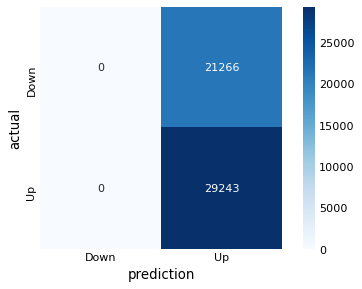

In [29]:
make_confusion_matrix(lm1, threshold=0.5)